In [17]:
import earthaccess
import json
from shapely.geometry import shape
import folium
import geopandas as gpd
import numpy as np
from IPython.display import HTML
import xarray as xr
from PIL import Image
import io
import base64
import requests


# 1. Load ski areas geojson

In [18]:
file_path = 'ski_areas.geojson'
with open(file_path, 'r') as f:
    # Load the JSON data
    ski_areas = json.load(f)["features"]

In [19]:
crystal = list(filter(lambda x: x["properties"]["name"] == "Crystal Mountain", ski_areas))[0]
crystal_polygon = crystal["geometry"]

In [20]:
crystal_shapely_polygon = shape(crystal_polygon)

In [21]:
minx, miny, maxx, maxy = crystal_shapely_polygon.bounds

print(f"Bounding Box: (minx={minx}, miny={miny}, maxx={maxx}, maxy={maxy})")

Bounding Box: (minx=-121.5089145, miny=46.90889530000001, maxx=-121.46718410000003, maxy=46.9567407)


# 2. Use `earthaccess` to find and read ATL06 granules for an overlapping area

In [22]:
earthaccess.login()

In [23]:
start_date, end_date = '2023-11-01', '2024-04-30'

In [24]:
results = earthaccess.search_data(
    short_name='ATL06',
    bounding_box=(minx, miny, maxx, maxy),
    temporal=(start_date, end_date),
    count=10
)

In [25]:
len(results)

3

In [26]:
atl06_granule = results[0]

In [27]:
access = 'https' # or 's3'

In [28]:
ground_segments = ['gt1l', 'gt2l', 'gt2r', 'gt3l', 'gt3r']

In [29]:
if access == 's3':
    file_url = atl06_granule.data_links(access='direct')[0]
    nsidc_fs = earthaccess.get_s3_filesystem(daac='NSIDC')
elif access == 'https':
    file_url = atl06_granule.data_links(access='https')[0]
    nsidc_fs = earthaccess.get_fsspec_https_session()
else:
    raise ValueError(f"Invalid access type: {access}")

ds = xr.open_dataset(nsidc_fs.open(file_url), group=f'/{ground_segments[0]}/land_ice_segments')

In [30]:
ds

<xarray.Dataset> Size: 3MB
Dimensions:                (delta_time: 71723)
Coordinates:
  * delta_time             (delta_time) datetime64[ns] 574kB 2023-12-17T17:29...
    latitude               (delta_time) float64 574kB ...
    longitude              (delta_time) float64 574kB ...
Data variables:
    atl06_quality_summary  (delta_time) int8 72kB ...
    h_li                   (delta_time) float32 287kB ...
    h_li_sigma             (delta_time) float32 287kB ...
    segment_id             (delta_time) float64 574kB ...
    sigma_geo_h            (delta_time) float32 287kB ...
Attributes:
    Description:  The land_ice_height group contains the primary set of deriv...
    data_rate:    Data within this group are sparse.  Data values are provide...

### Create and subset ATL06 data to a test area 

ATL06 data are very "long" granules. We want to subset them to data near, but not exactly overlapping, the ski resort area. This is because ski resorts are small and finding icesat-2 points which exactly overlap may be prohibitively difficult.

In [31]:
test_extent = {
    'minx': minx - 0.5,
    'miny': miny - 0.5,
    'maxx': maxx + 0.5,
    'maxy': maxy + 0.5
}


In [32]:
# filter to the bbox

subset_ds = ds.where(
    (ds.latitude >= test_extent['miny']) & (ds.latitude <= test_extent['maxy']) & 
    (ds.longitude >= test_extent['minx']) & (ds.longitude <= test_extent['maxx']),
    drop=True
)

In [33]:
subset_ds

<xarray.Dataset> Size: 258kB
Dimensions:                (delta_time: 5385)
Coordinates:
  * delta_time             (delta_time) datetime64[ns] 43kB 2023-12-17T17:32:...
    latitude               (delta_time) float64 43kB 47.46 47.46 ... 46.41 46.41
    longitude              (delta_time) float64 43kB -121.5 -121.5 ... -121.6
Data variables:
    atl06_quality_summary  (delta_time) float32 22kB 1.0 1.0 1.0 ... 1.0 1.0 1.0
    h_li                   (delta_time) float32 22kB 1.382e+03 ... 1.154e+03
    h_li_sigma             (delta_time) float32 22kB 4.166 9.022 ... 4.876 1.328
    segment_id             (delta_time) float64 43kB 7.383e+05 ... 7.442e+05
    sigma_geo_h            (delta_time) float32 22kB 0.3636 18.09 ... 0.344
Attributes:
    Description:  The land_ice_height group contains the primary set of deriv...
    data_rate:    Data within this group are sparse.  Data values are provide...

In [34]:

# Create a map centered on the polygon
center_lat = (miny + maxy) / 2
center_lon = (minx + maxx) / 2

# Create the map
m = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=8,
    tiles='OpenStreetMap'
)

# Convert the shapely polygon to a GeoDataFrame for easy plotting
crystal_gdf = gpd.GeoDataFrame(
    geometry=[crystal_shapely_polygon],
    crs="EPSG:4326"  # WGS84 coordinate system
)

folium.Rectangle(
    bounds=[[test_extent['miny'], test_extent['minx']], [test_extent['maxy'], test_extent['maxx']]],
    name='Test Area',
    style_function=lambda feature: {
        'fillColor': 'blue',
        'color': 'blue',
        'weight': 2,
        'fillOpacity': 0.3
    },
    popup=folium.Popup('Test Area', parse_html=True)
).add_to(m)

# Add the polygon to the map
folium.GeoJson(
    crystal_gdf,
    name='Crystal Mountain Ski Area',
    style_function=lambda feature: {
        'fillColor': 'red',
        'color': 'darkred',
        'weight': 2,
        'fillOpacity': 0.3
    },
    popup=folium.Popup('Crystal Mountain Ski Area', parse_html=True)
).add_to(m)

# Filter out NaN values and create circles
valid_points = [
    (lat, lon, val) for lat, lon, val in zip(
        subset_ds.latitude.values,
        subset_ds.longitude.values,
        subset_ds.h_li.values
    ) if not (np.isnan(lat) or np.isnan(lon) or np.isnan(val))
]

# Add all circles at once
for lat, lon, value in valid_points:
    folium.CircleMarker(
        location=[lat, lon],
        radius=1,
        color='green',
        fill=True,
        fillOpacity=0.7,
        popup=f'Height: {value:.1f} m'
    ).add_to(m)

# Display with custom size using HTML
html = m._repr_html_()
html_with_size = f'<div style="width: 500px; height: 400px;">{html}</div>'
HTML(html_with_size)

### Subtract DEM to get snow depth

There is an issue here: the accuracy may not be reliable as some snow depths are returning negative.

Should we check for snow coverage first? Is there a more reliable way to subtract DEM?

Perhaps a simpler problem would be to measure snow coverage in pixels. We would just need HLS and a snow coverage dataset to do this. But there are already products that do this?

https://chatgpt.com/s/t_68a7616819cc8191bc12ff3842c63cc1

another idea is to use ground-truth data such as SNOTEL (US)

to read, ERA downscaled using icesat-2 for snow depth: https://arxiv.org/abs/2410.17934?utm_source=chatgpt.com


In [36]:
def epqs_elev(lon, lat, units="Meters"):
    url = "https://epqs.nationalmap.gov/v1/json"
    r = requests.get(url, params={"x": lon, "y": lat, "wkid": 4326, "units": units})
    r.raise_for_status()
    return float(r.json()["value"])

# subset_ds has lon, lat, h_li
snow_depths = []
for h_li, lon, lat in zip(subset_ds.h_li.values[0:10], subset_ds.longitude.values[0:10], subset_ds.latitude.values[0:10]):
    snow_depth = h_li - epqs_elev(lon, lat)
    if snow_depth > 0:
        snow_depths.append(snow_depth)
    else:
        print(f"Snow depth is negative: {snow_depth}")

snow_depths


Snow depth is negative: nan
Snow depth is negative: nan
Snow depth is negative: -18.1002197265625
Snow depth is negative: nan
Snow depth is negative: nan
Snow depth is negative: -215.4271240234375


[np.float32(45.86621),
 np.float32(72.265625),
 np.float32(17.446777),
 np.float32(12.062256)]

In [20]:
snow_depth

[np.float32(45.86621),
 np.float32(72.265625),
 np.float32(17.446777),
 np.float32(12.062256),
 np.float32(nan),
 np.float32(nan),
 np.float32(-18.10022),
 np.float32(nan),
 np.float32(nan),
 np.float32(-215.42712)]

# Find coincident HLS data using bounding box and cloud cover and date of atl06

In [58]:
temporal_extent = atl06_granule["umm"]["TemporalExtent"]["RangeDateTime"]
start_date, end_date = temporal_extent["BeginningDateTime"], temporal_extent["EndingDateTime"]

In [59]:
start_date, end_date

('2023-12-17T17:29:46.809Z', '2023-12-17T17:35:38.000Z')

In [60]:
from datetime import datetime, timedelta

date_obj = datetime.fromisoformat(start_date.replace('Z', '+00:00'))

# Create week window
week_start = date_obj - timedelta(days=3.5)
week_end = date_obj + timedelta(days=3.5)

In [61]:
hls_granules = earthaccess.search_data(
    short_name='HLSL30',
    bounding_box=(test_extent['minx'], test_extent['miny'], test_extent['maxx'], test_extent['maxy']),
    temporal=(week_start, week_end),
    count=10
)

hls_granules

[Collection: {'EntryTitle': 'HLS Landsat Operational Land Imager Surface Reflectance and TOA Brightness Daily Global 30m v2.0'}
 Spatial coverage: {'HorizontalSpatialDomain': {'Geometry': {'GPolygons': [{'Boundary': {'Points': [{'Longitude': -121.55985018, 'Latitude': 46.85663988}, {'Longitude': -121.54054098, 'Latitude': 47.56503918}, {'Longitude': -121.78844857, 'Latitude': 46.85928805}, {'Longitude': -121.55985018, 'Latitude': 46.85663988}]}}]}}}
 Temporal coverage: {'RangeDateTime': {'BeginningDateTime': '2023-12-15T18:49:40.017Z', 'EndingDateTime': '2023-12-15T18:50:03.904Z'}}
 Size(MB): 13.019248962402344
 Data: ['https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TET.2023349T184940.v2.0/HLS.L30.T10TET.2023349T184940.v2.0.VAA.tif', 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TET.2023349T184940.v2.0/HLS.L30.T10TET.2023349T184940.v2.0.B04.tif', 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HL

In [74]:
hls_granule = hls_granules[1]

In [75]:
bounding_points = hls_granule["umm"]["SpatialExtent"]["HorizontalSpatialDomain"]["Geometry"]["GPolygons"][0]["Boundary"]["Points"]
latitudes = [point["Latitude"] for point in bounding_points]
longitudes = [point["Longitude"] for point in bounding_points]

hls_granule_bounds = [
    [min(latitudes), min(longitudes)],
    [max(latitudes), max(longitudes)]
]

In [76]:
bands_to_files = {link.split('/')[-1].split('.')[-2]: link for link in hls_granule.data_links()}
bands_to_files

{'B07': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.B07.tif',
 'SZA': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.SZA.tif',
 'B02': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.B02.tif',
 'B06': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.B06.tif',
 'B05': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.B05.tif',
 'B10': 'https://data.lpdaac.earthdatacloud.nasa.gov/lp-prod-protected/HLSL30.020/HLS.L30.T10TFS.2023349T184940.v2.0/HLS.L30.T10TFS.2023349T184940.v2.0.B10.tif',
 'B11': 'https://data.lpdaac

In [77]:
import rasterio

if access == 's3':
    print("TODO")
    # file_url = hls_granule.data_links(access='direct')[0]
    # lpdaac_fs = earthaccess.get_s3_filesystem(daac='LPDAAC')
elif access == 'https':
    lpdaac_fs = earthaccess.get_fsspec_https_session()
else:
    raise ValueError(f"Invalid access type: {access}")


In [78]:

src = rasterio.open(lpdaac_fs.open(bands_to_files['B02']))
blue = src.read(1)
profile = src.profile
green = rasterio.open(lpdaac_fs.open(bands_to_files['B03'])).read(1)
red = rasterio.open(lpdaac_fs.open(bands_to_files['B04'])).read(1)

In [79]:
rgb = np.stack([red, green, blue], axis=0)

In [80]:
# Normalize the data for visualization (0-1 range)
def normalize_band(band):
    band_min = np.nanpercentile(band, 2)  # 2nd percentile
    band_max = np.nanpercentile(band, 98)  # 98th percentile
    return (band - band_min) / (band_max - band_min)

rgb_normalized = np.stack([
    normalize_band(red),
    normalize_band(green), 
    normalize_band(blue)
], axis=0)

# Clip to valid range
rgb_normalized = np.clip(rgb_normalized, 0, 1)

# Convert to 8-bit (0-255)
rgb_8bit = (rgb_normalized * 255).astype(np.uint8)

# Update profile for 3 bands
profile.update(
    count=3,  # Number of bands
    dtype='float32'  # Data type
)

# Save as GeoTIFF
output_path = "hls_true_color.tif"
with rasterio.open(output_path, 'w', **profile) as dst:
    dst.write(rgb_8bit)

In [81]:
# Add the image overlay to your existing map 'm'
# First, convert your rgb_8bit to base64
rgb_image = Image.fromarray(np.transpose(rgb_8bit, (1, 2, 0)))
img_buffer = io.BytesIO()
rgb_image.save(img_buffer, format='PNG')
img_buffer.seek(0)
img_str = base64.b64encode(img_buffer.read()).decode()

In [82]:
folium.raster_layers.ImageOverlay(
    name='True Color Image',
    image=f'data:image/png;base64,{img_str}',
    bounds=hls_granule_bounds,
    opacity=0.8,
    popup='HLS True Color Image'
).add_to(m)


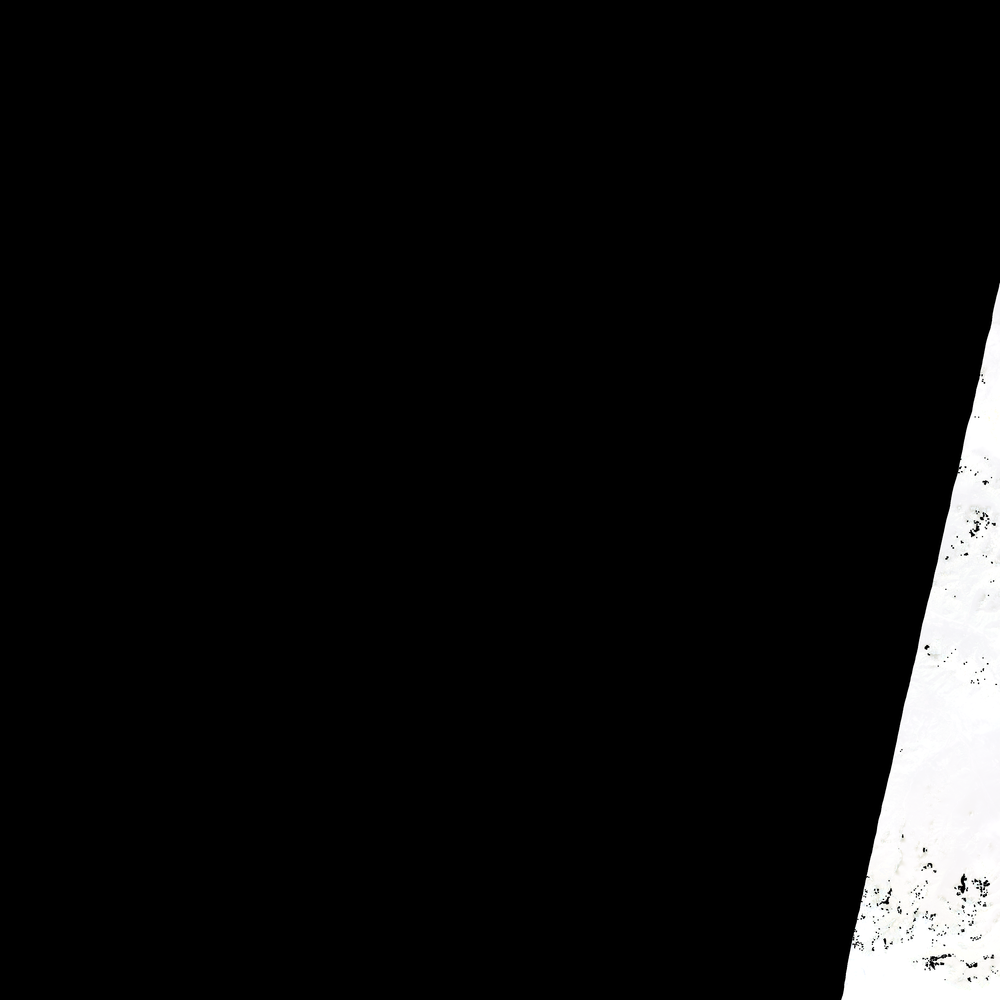
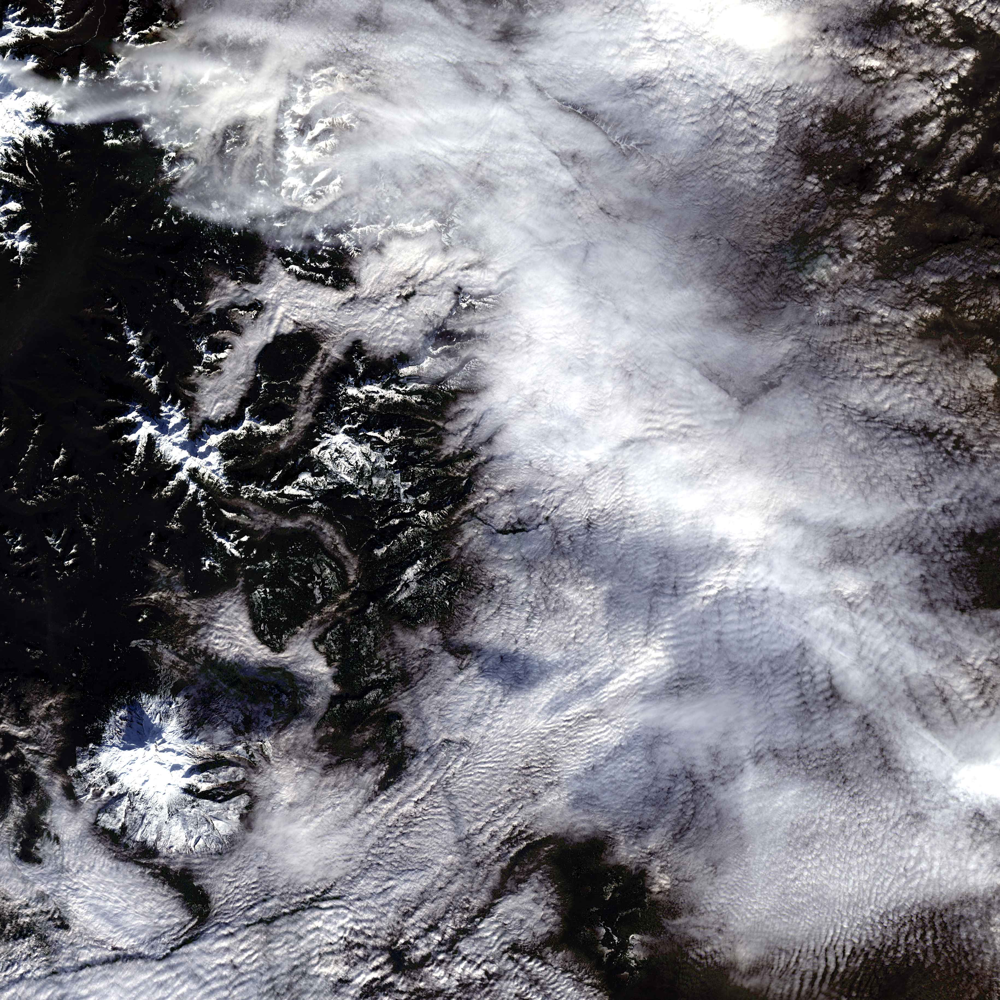

In [83]:
m

In [72]:
subset_ds

<xarray.Dataset> Size: 258kB
Dimensions:                (delta_time: 5385)
Coordinates:
  * delta_time             (delta_time) datetime64[ns] 43kB 2023-12-17T17:32:...
    latitude               (delta_time) float64 43kB 47.46 47.46 ... 46.41 46.41
    longitude              (delta_time) float64 43kB -121.5 -121.5 ... -121.6
Data variables:
    atl06_quality_summary  (delta_time) float32 22kB 1.0 1.0 1.0 ... 1.0 1.0 1.0
    h_li                   (delta_time) float32 22kB 1.382e+03 ... 1.154e+03
    h_li_sigma             (delta_time) float32 22kB 4.166 9.022 ... 4.876 1.328
    segment_id             (delta_time) float64 43kB 7.383e+05 ... 7.442e+05
    sigma_geo_h            (delta_time) float32 22kB 0.3636 18.09 ... 0.344
Attributes:
    Description:  The land_ice_height group contains the primary set of deriv...
    data_rate:    Data within this group are sparse.  Data values are provide...

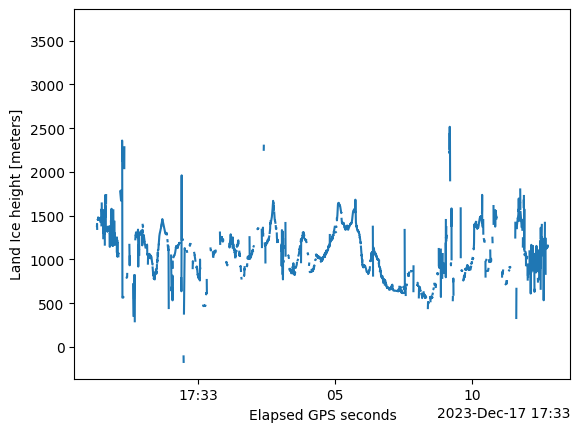

In [73]:
subset_ds.h_li.plot()

In [ ]:
snow_depth.hist()